<a href="https://colab.research.google.com/github/shreya139/MiningMavericks/blob/Zeel-Gudhka/202218025_Zeel_Gudhka_IDM_CP1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Task 1: Predicting Snow Depth (SNWD) using Linear, Ridge, Lasso and Polynomial Regression
##Task 2: Predicting Average Temperature (TAVG) using Linear, Ridge, Lasso and Polynomial Regression

Importing Libraries

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.subplots as sp
import plotly.graph_objs as go
from datetime import datetime
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error, r2_score
import warnings
warnings.filterwarnings('ignore')

#Data Preprocessing and EDA
##Loading the dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
weather_data = pd.read_csv('/content/drive/MyDrive/Classroom/IntroductionToDataMining/the weather of 187 countries in 2020.csv')

In [ ]:
weather_data.head(15)

,STATION,Country/Region,DATE,Year,Month,Day,PRCP,SNWD,TAVG,TMAX,...,LONGITUDE,ELEVATION,PRCP_ATTRIBUTES,TAVG_ATTRIBUTES,TMAX_ATTRIBUTES,TMIN_ATTRIBUTES,DAPR,MDPR,WESD,SNWD_ATTRIBUTES
0,TZ000063894,Comoros,2020-01-22,2020,1,22,10.9,NaN,27.6,30.2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,TZ000063894,Comoros,2020-01-23,2020,1,23,0.0,NaN,26.7,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,TZ000063894,Comoros,2020-01-24,2020,1,24,9.4,NaN,27.9,30.6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,TZ000063894,Comoros,2020-01-25,2020,1,25,0.3,NaN,27.9,30.2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,TZ000063894,Comoros,2020-01-26,2020,1,26,0.0,NaN,28.2,31.5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,TZ000063894,Comoros,2020-01-27,2020,1,27,NaN,NaN,27.9,32.5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,TZ000063894,Comoros,2020-01-28,2020,1,28,8.9,NaN,27.6,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,TZ000063894,Comoros,2020-01-29,2020,1,29,5.1,NaN,28.6,32.5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,TZ000063894,Comoros,2020-01-30,2020,1,30,0.0,NaN,28.4,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,TZ000063894,Comoros,2020-01-31,2020,1,31,NaN,NaN,26.3,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
weather_data.shape

(1392575, 23)

In [ ]:
weather_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1392575 entries, 0 to 1392574
Data columns (total 23 columns):
 #   Column           Non-Null Count    Dtype  
---  ------           --------------    -----  
 0   STATION          1392575 non-null  object 
 1   Country/Region   1392575 non-null  object 
 2   DATE             1392575 non-null  object 
 3   Year             1392575 non-null  int64  
 4   Month            1392575 non-null  int64  
 5   Day              1392575 non-null  int64  
 6   PRCP             1043369 non-null  float64
 7   SNWD             377429 non-null   float64
 8   TAVG             878632 non-null   float64
 9   TMAX             866705 non-null   float64
 10  TMIN             898381 non-null   float64
 11  SNOW             105392 non-null   float64
 12  LATITUDE         104742 non-null   float64
 13  LONGITUDE        104742 non-null   float64
 14  ELEVATION        104742 non-null   float64
 15  PRCP_ATTRIBUTES  6007 non-null     object 
 16  TAVG_ATTRIBUTES  3

Checking for duplicate rows and removing them if any

In [ ]:
weather_data.duplicated().sum()

22456

In [ ]:
weather_data = weather_data.drop_duplicates()
weather_data = pd.DataFrame(weather_data)

Checking for null values in all the columns of the dataset

In [ ]:
weather_data.isnull().sum()

STATION                  0
Country/Region           0
DATE                     0
Year                     0
Month                    0
Day                      0
PRCP                346830
SNWD                992692
TAVG                513943
TMAX                517620
TMIN                485944
SNOW               1264727
LATITUDE           1265377
LONGITUDE          1265377
ELEVATION          1265377
PRCP_ATTRIBUTES    1364112
TAVG_ATTRIBUTES    1366269
TMAX_ATTRIBUTES    1364482
TMIN_ATTRIBUTES    1364245
DAPR               1368826
MDPR               1370038
WESD               1370117
SNWD_ATTRIBUTES    1369765
dtype: int64

Checking for unique values in all the columns if total number of unique values are less than or equal to 50

In [ ]:
columns_to_check = weather_data.columns
for col in columns_to_check:
  unique_values = weather_data[col].unique()
  if len(unique_values) <= 50:
    print(f"Unique values in column '{col}': {unique_values}")
    for value in unique_values:
      count = (weather_data[col] == value).sum()
      print(f"Count of '{value}': {count}")

Unique values in column 'Year': [2020]
Count of '2020': 1370119
Unique values in column 'Month': [1 2 3 4 5 6 7]
Count of '1': 73608
Count of '2': 211034
Count of '3': 227409
Count of '4': 216658
Count of '5': 225389
Count of '6': 219146
Count of '7': 196875
Unique values in column 'Day': [22 23 24 25 26 27 28 29 30 31  1  2  3  4  5  6  7  8  9 10 11 12 13 14
 15 16 17 18 19 20 21]
Count of '22': 50920
Count of '23': 50947
Count of '24': 50985
Count of '25': 50873
Count of '26': 50886
Count of '27': 50898
Count of '28': 43722
Count of '29': 43745
Count of '30': 36400
Count of '31': 21947
Count of '1': 43742
Count of '2': 43689
Count of '3': 43853
Count of '4': 43674
Count of '5': 43791
Count of '6': 43803
Count of '7': 43772
Count of '8': 43816
Count of '9': 43686
Count of '10': 43754
Count of '11': 43680
Count of '12': 43806
Count of '13': 43760
Count of '14': 43624
Count of '15': 43682
Count of '16': 43753
Count of '17': 43857
Count of '18': 43784
Count of '19': 43779
Count of '20':

Dropping the STATION column as I want to do country wise prediction, DATE column as we have month and day columns, and Year column since it has only 1 value for all the *rows*

In [ ]:
weather_data = weather_data.drop(axis=1, columns=['STATION', 'DATE', 'Year'])
weather_data = pd.DataFrame(weather_data)
weather_data.shape

(1370119, 20)

In [ ]:
weather_data.head()

,Country/Region,Month,Day,PRCP,SNWD,TAVG,TMAX,TMIN,SNOW,LATITUDE,LONGITUDE,ELEVATION,PRCP_ATTRIBUTES,TAVG_ATTRIBUTES,TMAX_ATTRIBUTES,TMIN_ATTRIBUTES,DAPR,MDPR,WESD,SNWD_ATTRIBUTES
0,Comoros,1,22,10.9,NaN,27.6,30.2,24.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Comoros,1,23,0.0,NaN,26.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Comoros,1,24,9.4,NaN,27.9,30.6,25.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Comoros,1,25,0.3,NaN,27.9,30.2,16.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Comoros,1,26,0.0,NaN,28.2,31.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Checking for missing values, yellow indicates the missing values in a particular column

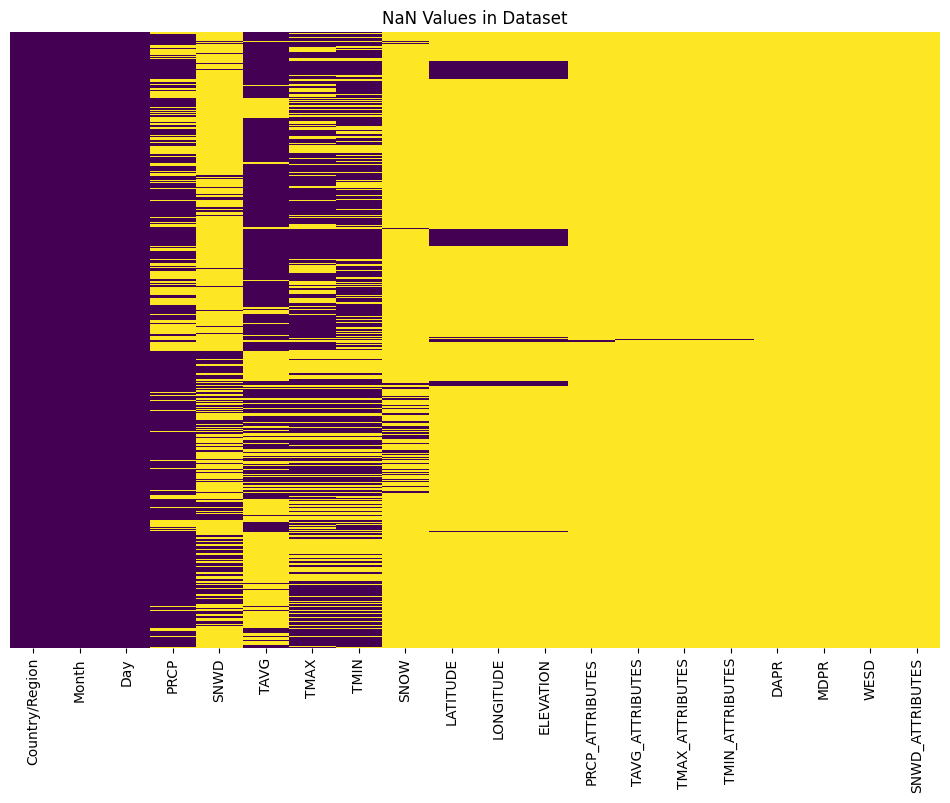

In [ ]:
nan_df = weather_data.isnull()
plt.figure(figsize=(12, 8))
sns.heatmap(nan_df, cmap='viridis', cbar=False, yticklabels=False)
plt.title('NaN Values in Dataset')
plt.show()

Dropping the columns that have more than 80% missing values

In [ ]:
null_percentage = (weather_data.isnull().sum() / len(weather_data)) * 100
threshold = 80
columns_to_drop = null_percentage[null_percentage > threshold].index
weather_data = weather_data.drop(columns=columns_to_drop)
weather_data = pd.DataFrame(weather_data)

In [ ]:
weather_data.head(15)

,Country/Region,Month,Day,PRCP,SNWD,TAVG,TMAX,TMIN
0,Comoros,1,22,10.9,NaN,27.6,30.2,24.9
1,Comoros,1,23,0.0,NaN,26.7,NaN,NaN
2,Comoros,1,24,9.4,NaN,27.9,30.6,25.6
3,Comoros,1,25,0.3,NaN,27.9,30.2,16.3
4,Comoros,1,26,0.0,NaN,28.2,31.5,NaN
5,Comoros,1,27,NaN,NaN,27.9,32.5,NaN
6,Comoros,1,28,8.9,NaN,27.6,NaN,25.0
7,Comoros,1,29,5.1,NaN,28.6,32.5,26.0
8,Comoros,1,30,0.0,NaN,28.4,NaN,NaN
9,Comoros,1,31,NaN,NaN,26.3,NaN,NaN


In [ ]:
weather_data.shape

(1370119, 8)

In [ ]:
columns_to_plot = ["TMIN", "TAVG", "TMAX"]
fig = sp.make_subplots(rows=2, cols=2, subplot_titles=("TMIN Distribution", "TAVG Distribution", "TMAX Distribution", ))

for i, column in enumerate(columns_to_plot, 1):
  row, col = divmod(i - 1, 2)
  trace = go.Histogram(x=weather_data[column], name=column)
  fig.add_trace(trace, row=row + 1, col=col + 1)

fig.update_layout(title="Distributions of Weather Attributes", showlegend=True)
fig.show()

Since the data is not distributed normally, imputing mean for missing values will not make it robust to outliers

Dropping the rows where either of PRCP, TMIN and TMAX value is NaN and filling the missing values in TAVG by taking the average of TMIN and TMAX

In [ ]:
mask = (weather_data['PRCP'].isna() | weather_data['TMIN'].isna() | weather_data['TMAX'].isna())
weather_data = weather_data[~mask]
weather_data.reset_index(drop=True, inplace=True)

In [ ]:
mask = ((weather_data['TAVG'] == 0) | weather_data['TAVG'].isna())
average_temp = (weather_data['TMIN'] + weather_data['TMAX']) / 2
weather_data.loc[mask, 'TAVG'] = average_temp[mask]

In [ ]:
weather_data.head(15)

,Country/Region,Month,Day,PRCP,SNWD,TAVG,TMAX,TMIN
0,Comoros,1,22,10.9,NaN,27.6,30.2,24.9
1,Comoros,1,24,9.4,NaN,27.9,30.6,25.6
2,Comoros,1,25,0.3,NaN,27.9,30.2,16.3
3,Comoros,1,29,5.1,NaN,28.6,32.5,26.0
4,Comoros,2,18,0.3,NaN,29.4,34.0,25.7
5,Comoros,2,20,0.0,NaN,29.2,33.6,25.7
6,Comoros,2,21,0.0,NaN,29.2,34.2,24.9
7,Comoros,2,27,1.8,NaN,29.0,33.9,24.3
8,Comoros,3,17,23.4,NaN,26.5,30.3,23.6
9,Comoros,3,20,0.3,NaN,27.3,32.8,23.7


In [ ]:
weather_data.shape

(589702, 8)

In [ ]:
weather_data.describe()

,Month,Day,PRCP,SNWD,TAVG,TMAX,TMIN
count,589702.000000,589702.000000,589702.000000,165157.000000,589702.000000,589702.000000,589702.000000
mean,4.309219,15.983621,2.271451,141.030888,9.991589,15.545551,4.462986
std,1.810580,8.783297,7.228532,299.423839,11.133483,11.708117,11.192029
min,1.000000,1.000000,0.000000,-20.000000,-56.200000,-55.000000,-65.000000
25%,3.000000,8.000000,0.000000,0.000000,3.400000,7.600000,-1.300000
50%,4.000000,16.000000,0.000000,0.000000,11.000000,16.600000,5.300000
75%,6.000000,24.000000,1.100000,170.000000,17.600000,24.100000,11.800000
max,7.000000,31.000000,374.900000,4840.000000,42.700000,51.200000,36.700000


values in 25 and 50 quartile are 0 for PRCP and SNWD

Gathering a list of countries that contain the data about SNWD

In [ ]:
countries_with_snwd = weather_data.loc[~weather_data['SNWD'].isna(), 'Country/Region'].unique()
countries_with_snwd

array(['Georgia', 'Monaco', 'US', 'Belarus', 'Switzerland', 'China',
       'Tajikistan', 'Lithuania', 'Romania', 'Finland', 'Argentina',
       'Japan', 'Ireland', 'Italy', 'Guatemala', 'Afghanistan', 'Russia',
       'Chile', 'Mexico', 'Bosnia and Herzegovina', 'Montenegro',
       'Taiwan', 'Kyrgyzstan', 'France', 'Azerbaijan', 'San Marino',
       'Serbia', 'Turkey', 'Uruguay', 'Slovenia', 'Portugal', 'Bolivia',
       'Austria', 'Poland', 'Czechia', 'Uzbekistan', 'Armenia',
       'Slovakia', 'North Macedonia', 'United Kingdom', 'Iran',
       'Mongolia', 'Kazakhstan', 'Holy See', 'Estonia', 'Netherlands',
       'Croatia', 'Canada', 'Moldova', 'Norway', 'Ukraine', 'Kosovo',
       'Liechtenstein', 'Morocco', 'Sweden', 'Germany', 'Bulgaria',
       'Spain'], dtype=object)

In [ ]:
filtered_data_snwd = weather_data[~weather_data['SNWD'].isna()]
country_snwd_counts = filtered_data_snwd.groupby('Country/Region')['SNWD'].count().reset_index()
country_snwd_counts.columns = ['Country/Region', 'SNWD Count']
country_snwd_counts = country_snwd_counts.sort_values(by='SNWD Count', ascending=False)
fig = px.bar(country_snwd_counts, x='Country/Region', y='SNWD Count', title='Count of SNWD Values by Country')
fig.update_layout(xaxis_title='Country', yaxis_title='SNWD Count')
fig.show()

Selecting top 14 countries that have the data about SNWD and checking if there are any NaN values in any of the rows belonging to that country

In [ ]:
countries = ["Canada", "Germany", "Russia", "Sweden", "Norway", "US", "United Kingdom", "China", "Taiwan", "Finland", "Switzerland", "Kosovo", "Montenegro", "Netherlands"]
countries_with_nan_snwd = []

for country in countries:
  country_snwd_values = weather_data.loc[weather_data['Country/Region'] == country, 'SNWD']
  nan_present = country_snwd_values.isna().any()
  if nan_present:
    countries_with_nan_snwd.append(country)

print("Countries with NaN values in SNWD:", countries_with_nan_snwd)

Countries with NaN values in SNWD: ['Canada', 'Germany', 'Russia', 'Sweden', 'Norway', 'US', 'United Kingdom', 'China', 'Taiwan', 'Finland', 'Switzerland', 'Kosovo', 'Montenegro', 'Netherlands']


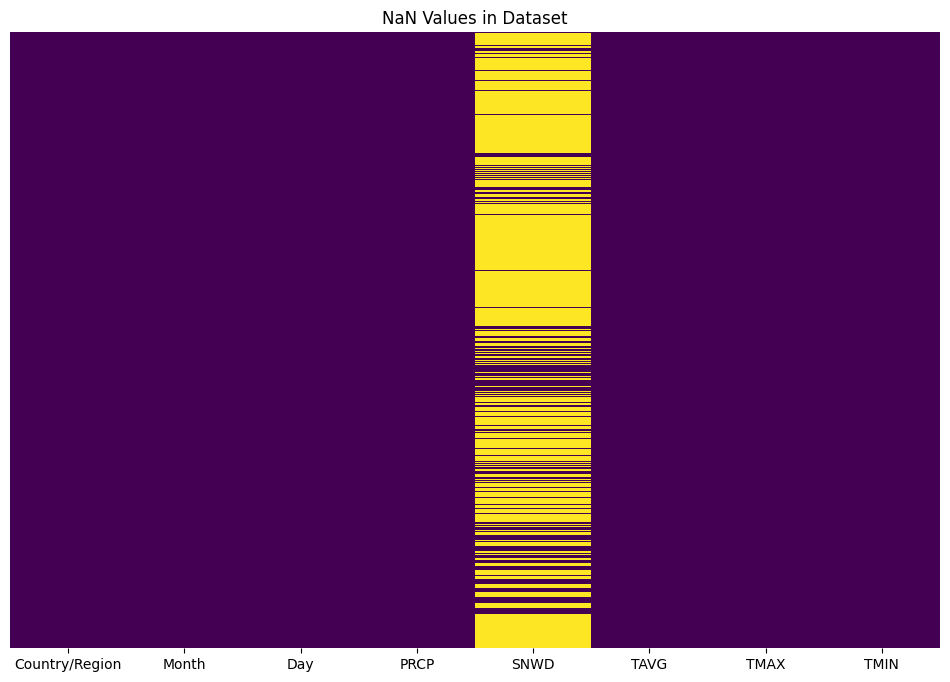

In [ ]:
nan_df = weather_data.isnull()
plt.figure(figsize=(12, 8))
sns.heatmap(nan_df, cmap='viridis', cbar=False, yticklabels=False)
plt.title('NaN Values in Dataset')
plt.show()

In [ ]:
countries = ["Canada", "Germany", "Russia", "Sweden", "Norway", "US", "United Kingdom", "China", "Taiwan", "Finland", "Switzerland", "Kosovo", "Montenegro", "Netherlands"]
non_nan_counts = {}
total_count = 0

for country in countries:
  country_data = weather_data[weather_data['Country/Region'] == country]
  non_nan_count = country_data['SNWD'].notna().sum()
  non_nan_counts[country] = non_nan_count

print("Count of non-NaN values in SNWD for each country:")
for country, count in non_nan_counts.items():
  print(f"{country}: {count}")

Count of non-NaN values in SNWD for each country:
Canada: 66525
Germany: 43463
Russia: 18241
Sweden: 12756
Norway: 7102
US: 3995
United Kingdom: 2026
China: 1854
Taiwan: 1854
Finland: 1741
Switzerland: 1126
Kosovo: 842
Montenegro: 842
Netherlands: 378


Retaining the data of 14 countries with no NaN value in SNWD column

In [ ]:
weather_data = weather_data[(weather_data['Country/Region'].isin(countries)) & (weather_data['SNWD'].notna())]
weather_data = pd.DataFrame(weather_data)

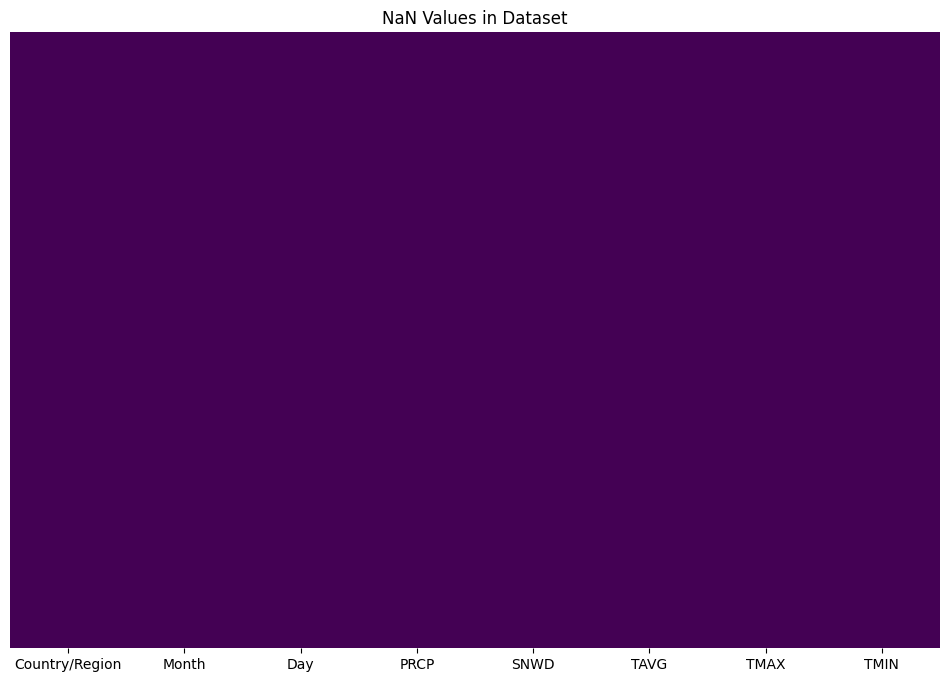

In [ ]:
nan_df = weather_data.isnull()
plt.figure(figsize=(12, 8))
sns.heatmap(nan_df, cmap='viridis', cbar=False, yticklabels=False)
plt.title('NaN Values in Dataset')
plt.show()

No missing values anymore

In [ ]:
weather_data.head(10)

,Country/Region,Month,Day,PRCP,SNWD,TAVG,TMAX,TMIN
12354,US,1,27,0.5,0.0,9.45,15.6,3.3
12355,US,1,28,0.0,0.0,5.85,11.1,0.6
12356,US,1,29,0.0,0.0,3.40,7.8,-1.0
12357,US,1,30,0.0,0.0,2.85,10.0,-4.3
12358,US,1,31,0.0,0.0,3.90,8.3,-0.5
12359,US,2,1,0.0,0.0,6.40,13.3,-0.5
12360,US,2,2,0.0,0.0,8.30,14.4,2.2
12363,US,2,6,0.0,0.0,-1.65,4.4,-7.7
12364,US,2,7,0.0,0.0,6.15,13.3,-1.0
12371,US,2,14,0.0,0.0,6.70,16.1,-2.7


In [ ]:
weather_data.tail(10)

,Country/Region,Month,Day,PRCP,SNWD,TAVG,TMAX,TMIN
556400,Germany,4,21,0.0,0.0,11.65,17.9,5.4
556401,Germany,4,22,0.0,0.0,11.10,19.9,2.3
556402,Germany,4,23,0.0,0.0,12.55,21.7,3.4
556403,Germany,4,24,0.0,0.0,12.95,20.7,5.2
556404,Germany,4,25,0.0,0.0,9.50,15.9,3.1
556405,Germany,4,26,0.0,0.0,9.90,19.4,0.4
556406,Germany,4,27,0.0,0.0,12.75,22.9,2.6
556407,Germany,4,28,6.4,0.0,12.60,20.6,4.6
556408,Germany,4,29,3.3,0.0,12.05,16.1,8.0
556409,Germany,4,30,16.5,0.0,12.20,17.4,7.0


In [ ]:
weather_data.shape

(162745, 8)

In [ ]:
countries = ["Canada", "Germany", "Russia", "Sweden", "Norway", "US", "United Kingdom", "China", "Taiwan", "Finland", "Switzerland", "Kosovo", "Montenegro", "Netherlands"]
for country in countries:
  country_data = weather_data[weather_data['Country/Region'] == country]
  fig = px.histogram(country_data, x='SNWD', title=f'SNWD Distribution in {country}')
  fig.update_xaxes(title='SNWD')
  fig.update_yaxes(title='Frequency')
  fig.show()

Maximum values for SNWD in all the countries range between 0-20

In [ ]:
fig_prcp = px.box(weather_data, y='PRCP', title='PRCP Box Plot')
fig_snwd = px.box(weather_data, y='SNWD', title='SNWD Box Plot')
fig_tavg = px.box(weather_data, y='TAVG', title='TAVG Box Plot')
fig_tmax = px.box(weather_data, y='TMAX', title='TMAX Box Plot')
fig_tmin = px.box(weather_data, y='TMIN', title='TMIN Box Plot')

fig_prcp.show()
fig_snwd.show()
fig_tavg.show()
fig_tmax.show()
fig_tmin.show()

Box plots for Temperature attributes look fine, but the box plots for prcp and snwd have most values as 0 and the rest are extreme values

Converting non-numeric data to numeric form by performing Label Encoding

In [ ]:
country_encoder = LabelEncoder()
weather_data['Country/Region'] = country_encoder.fit_transform(weather_data['Country/Region'])
weather_data.head(10)

,Country/Region,Month,Day,PRCP,SNWD,TAVG,TMAX,TMIN
12354,12,1,27,0.5,0.0,9.45,15.6,3.3
12355,12,1,28,0.0,0.0,5.85,11.1,0.6
12356,12,1,29,0.0,0.0,3.40,7.8,-1.0
12357,12,1,30,0.0,0.0,2.85,10.0,-4.3
12358,12,1,31,0.0,0.0,3.90,8.3,-0.5
12359,12,2,1,0.0,0.0,6.40,13.3,-0.5
12360,12,2,2,0.0,0.0,8.30,14.4,2.2
12363,12,2,6,0.0,0.0,-1.65,4.4,-7.7
12364,12,2,7,0.0,0.0,6.15,13.3,-1.0
12371,12,2,14,0.0,0.0,6.70,16.1,-2.7


#SNWD Prediction (1): Scaling the features after splitting the dataset into Train and Test sets

In [ ]:
snwd_data = weather_data.copy()

Separating the target variable from rest of the dataset

In [ ]:
X = snwd_data.drop(columns=['SNWD'])
y = snwd_data[['SNWD']]

In [ ]:
X.shape

(162745, 7)

In [ ]:
y.shape

(162745, 1)

Splitting the data into train and test sets

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print("Train set shape:", X_train.shape, y_train.shape)
print("Test set shape:", X_test.shape, y_test.shape)

Train set shape: (130196, 7) (130196, 1)
Test set shape: (32549, 7) (32549, 1)


Scaling the features

In [ ]:
columns_to_scale = ['PRCP', 'TAVG', 'TMAX', 'TMIN']
scaler = MinMaxScaler()
X_train_scaled = X_train.copy()
X_train_scaled[columns_to_scale] = scaler.fit_transform(X_train_scaled[columns_to_scale])
y_scaler = MinMaxScaler()
y_train = y_scaler.fit_transform(y_train)

##Model Fitting

Simple Linear Regression

In [ ]:
model = LinearRegression()
model.fit(X_train_scaled, y_train)
y_pred = model.predict(X_test)

mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error:", mse)
print("Root Mean Squared Error:", mse)
print("R-squared:", r2)

Mean Squared Error: 105536.00475675002
Root Mean Squared Error: 105536.00475675002
R-squared: -0.21401966086681967


Ridge Regression

In [ ]:
ridge_model = Ridge(alpha=0.01)
ridge_model.fit(X_train_scaled, y_train)
y_pred_ridge = ridge_model.predict(X_test)

mse_ridge = mean_squared_error(y_test, y_pred_ridge)
rmse_ridge = np.sqrt(mse_ridge)
r2_ridge = r2_score(y_test, y_pred_ridge)

print("Ridge Regression:")
print("Mean Squared Error:", mse_ridge)
print("Root Mean Squared Error:", rmse_ridge)
print("R-squared:", r2_ridge)

Ridge Regression:
Mean Squared Error: 105536.12284385283
Root Mean Squared Error: 324.86323713811146
R-squared: -0.21402101926639938


Lasso Regression

In [ ]:
lasso_model = Lasso(alpha=0.01)
lasso_model.fit(X_train_scaled, y_train)
y_pred_lasso = lasso_model.predict(X_test)

mse_lasso = mean_squared_error(y_test, y_pred_lasso)
rmse_lasso = np.sqrt(mse_lasso)
r2_lasso = r2_score(y_test, y_pred_lasso)

print("Lasso Regression:")
print("Mean Squared Error:", mse_lasso)
print("Root Mean Squared Error:", rmse_lasso)
print("R-squared:", r2_lasso)

Lasso Regression:
Mean Squared Error: 106097.10225650306
Root Mean Squared Error: 325.72550139113
R-squared: -0.22047417274580794


Ploynomial Regression

In [ ]:
poly_features = PolynomialFeatures(degree=3)
X_train_poly = poly_features.fit_transform(X_train_scaled)
X_test_poly = poly_features.transform(X_test)
poly_model = LinearRegression()
poly_model.fit(X_train_poly, y_train)
y_pred_poly = poly_model.predict(X_test_poly)

mse_poly = mean_squared_error(y_test, y_pred_poly)
rmse_poly = np.sqrt(mse_poly)
r2_poly = r2_score(y_test, y_pred_poly)

print("Polynomial Regression:")
print("Mean Squared Error:", mse_poly)
print("Root Mean Squared Error:", rmse_poly)
print("R-squared:", r2_poly)

Polynomial Regression:
Mean Squared Error: 6228057614.207163
Root Mean Squared Error: 78918.04365420599
R-squared: -71642.64815672253


#SNWD Prediction (2): Scaling the features before splitting the dataset into Train and Test sets

In [ ]:
snwd_data = weather_data.copy()

Seperating the target variable from rest of the dataset

In [ ]:
X = snwd_data.drop(columns=['SNWD'])
y = snwd_data[['SNWD']]

In [ ]:
X.shape

(162745, 7)

In [ ]:
y.shape

(162745, 1)

Scaling the features

In [ ]:
columns_to_scale = ['PRCP', 'TAVG', 'TMAX', 'TMIN']
scaler = MinMaxScaler()
X_scaled = X.copy()
X_scaled[columns_to_scale] = scaler.fit_transform(X[columns_to_scale])
y_scaler = MinMaxScaler()
y_scaled = y_scaler.fit_transform(y)

Splitting the dataset into train and test sets

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_scaled, test_size=0.2, random_state=42)
print("Train set shape:", X_train.shape, y_train.shape)
print("Test set shape:", X_test.shape, y_test.shape)

Train set shape: (130196, 7) (130196, 1)
Test set shape: (32549, 7) (32549, 1)


##Model Fitting

Simple Linear Regression

In [ ]:
model = LinearRegression()
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error:", mse)
print("Root Mean Squared Error:", rmse)
print("R-squared:", r2)

Mean Squared Error: 0.0029728090442144987
Root Mean Squared Error: 0.054523472415231394
R-squared: 0.19227295781369735


Ridge Regression

In [ ]:
ridge_model = Ridge(alpha=0.01)
ridge_model.fit(X_train, y_train)
y_pred_ridge = ridge_model.predict(X_test)

mse_ridge = mean_squared_error(y_test, y_pred_ridge)
rmse_ridge = np.sqrt(mse_ridge)
r2_ridge = r2_score(y_test, y_pred_ridge)

print("Ridge Regression:")
print("Mean Squared Error:", mse_ridge)
print("Root Mean Squared Error:", rmse_ridge)
print("R-squared:", r2_ridge)

Ridge Regression:
Mean Squared Error: 0.0029728101493869566
Root Mean Squared Error: 0.054523482550062376
R-squared: 0.1922726575328293


Lasso Regression

In [ ]:
lasso_model = Lasso(alpha=0.001)
lasso_model.fit(X_train, y_train)
y_pred_lasso = lasso_model.predict(X_test)

mse_lasso = mean_squared_error(y_test, y_pred_lasso)
rmse_lasso = np.sqrt(mse_lasso)
r2_lasso = r2_score(y_test, y_pred_lasso)

print("Lasso Regression:")
print("Mean Squared Error:", mse_lasso)
print("Root Mean Squared Error:", rmse_lasso)
print("R-squared:", r2_lasso)

Lasso Regression:
Mean Squared Error: 0.0030901067454135386
Root Mean Squared Error: 0.0555887285824522
R-squared: 0.16040258745501623


Polynomial Regression

In [ ]:
poly_features = PolynomialFeatures(degree=5)
X_train_poly = poly_features.fit_transform(X_train)
X_test_poly = poly_features.transform(X_test)
poly_model = LinearRegression()
poly_model.fit(X_train_poly, y_train)
y_pred_poly = poly_model.predict(X_test_poly)

mse_poly = mean_squared_error(y_test, y_pred_poly)
rmse_poly = np.sqrt(mse_poly)
r2_poly = r2_score(y_test, y_pred_poly)

print("Polynomial Regression:")
print("Mean Squared Error:", mse_poly)
print("Root Mean Squared Error:", rmse_poly)
print("R-squared:", r2_poly)

Polynomial Regression:
Mean Squared Error: 0.0024037607526343945
Root Mean Squared Error: 0.04902816285192006
R-squared: 0.34688621637925554


Polynomial Regression with degree 5 gives the best result amongst all

#Avg Temp Prediction

Loading the dataset

In [ ]:
data = pd.read_csv('/content/drive/MyDrive/Classroom/IntroductionToDataMining/the weather of 187 countries in 2020.csv')

In [ ]:
data.head(10)

,STATION,Country/Region,DATE,Year,Month,Day,PRCP,SNWD,TAVG,TMAX,...,LONGITUDE,ELEVATION,PRCP_ATTRIBUTES,TAVG_ATTRIBUTES,TMAX_ATTRIBUTES,TMIN_ATTRIBUTES,DAPR,MDPR,WESD,SNWD_ATTRIBUTES
0,TZ000063894,Comoros,2020-01-22,2020,1,22,10.9,NaN,27.6,30.2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,TZ000063894,Comoros,2020-01-23,2020,1,23,0.0,NaN,26.7,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,TZ000063894,Comoros,2020-01-24,2020,1,24,9.4,NaN,27.9,30.6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,TZ000063894,Comoros,2020-01-25,2020,1,25,0.3,NaN,27.9,30.2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,TZ000063894,Comoros,2020-01-26,2020,1,26,0.0,NaN,28.2,31.5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,TZ000063894,Comoros,2020-01-27,2020,1,27,NaN,NaN,27.9,32.5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,TZ000063894,Comoros,2020-01-28,2020,1,28,8.9,NaN,27.6,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,TZ000063894,Comoros,2020-01-29,2020,1,29,5.1,NaN,28.6,32.5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,TZ000063894,Comoros,2020-01-30,2020,1,30,0.0,NaN,28.4,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,TZ000063894,Comoros,2020-01-31,2020,1,31,NaN,NaN,26.3,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
data.shape

(1392575, 23)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1392575 entries, 0 to 1392574
Data columns (total 23 columns):
 #   Column           Non-Null Count    Dtype  
---  ------           --------------    -----  
 0   STATION          1392575 non-null  object 
 1   Country/Region   1392575 non-null  object 
 2   DATE             1392575 non-null  object 
 3   Year             1392575 non-null  int64  
 4   Month            1392575 non-null  int64  
 5   Day              1392575 non-null  int64  
 6   PRCP             1043369 non-null  float64
 7   SNWD             377429 non-null   float64
 8   TAVG             878632 non-null   float64
 9   TMAX             866705 non-null   float64
 10  TMIN             898381 non-null   float64
 11  SNOW             105392 non-null   float64
 12  LATITUDE         104742 non-null   float64
 13  LONGITUDE        104742 non-null   float64
 14  ELEVATION        104742 non-null   float64
 15  PRCP_ATTRIBUTES  6007 non-null     object 
 16  TAVG_ATTRIBUTES  3

Checking for duplicate rows and removing them if any

In [ ]:
data.duplicated().sum()

22456

In [ ]:
data = data.drop_duplicates()
data = pd.DataFrame(data)

Checking for null values

In [ ]:
data.isnull().sum()

STATION                  0
Country/Region           0
DATE                     0
Year                     0
Month                    0
Day                      0
PRCP                346830
SNWD                992692
TAVG                513943
TMAX                517620
TMIN                485944
SNOW               1264727
LATITUDE           1265377
LONGITUDE          1265377
ELEVATION          1265377
PRCP_ATTRIBUTES    1364112
TAVG_ATTRIBUTES    1366269
TMAX_ATTRIBUTES    1364482
TMIN_ATTRIBUTES    1364245
DAPR               1368826
MDPR               1370038
WESD               1370117
SNWD_ATTRIBUTES    1369765
dtype: int64

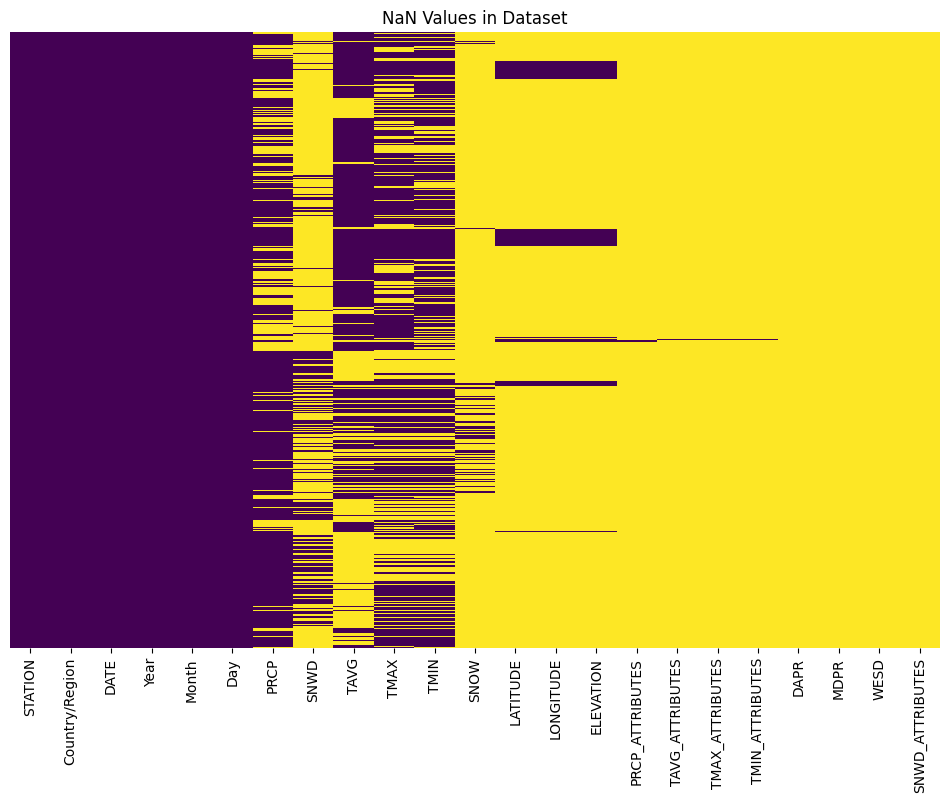

In [ ]:
nan_df = data.isnull()
plt.figure(figsize=(12, 8))
sns.heatmap(nan_df, cmap='viridis', cbar=False, yticklabels=False)
plt.title('NaN Values in Dataset')
plt.show()

Dropping STATION, DATE and Year columns as we do not need them for country-wise prediction

In [ ]:
data = data.drop(axis=1, columns=['STATION', 'DATE', 'Year'])
data = pd.DataFrame(data)
data.shape

(1370119, 20)

Dropping the columns that have more than 70% of null values

In [ ]:
null_percentage = (data.isnull().sum() / len(data)) * 100
threshold = 70
columns_to_drop = null_percentage[null_percentage > threshold].index
data = data.drop(columns=columns_to_drop)
data = pd.DataFrame(data)

Dropping the rows where either of prcp, tmin and tmax is null

In [ ]:
mask = (data['PRCP'].isna() | data['TMIN'].isna() | data['TMAX'].isna())
data = data[~mask]
data.reset_index(drop=True, inplace=True)

Calculating avg temp from tmin and tmax for the missing values in tavg

In [ ]:
mask = ((data['TAVG'] == 0) | data['TAVG'].isna())
average_temp = (data['TMIN'] + data['TMAX']) / 2
data.loc[mask, 'TAVG'] = average_temp[mask]

dropping tmin and tmax as we do not need them anymore

In [ ]:
data = data.drop(columns=['TMAX', 'TMIN'])
data = pd.DataFrame(data)

In [ ]:
data.head(10)

,Country/Region,Month,Day,PRCP,TAVG
0,Comoros,1,22,10.9,27.6
1,Comoros,1,24,9.4,27.9
2,Comoros,1,25,0.3,27.9
3,Comoros,1,29,5.1,28.6
4,Comoros,2,18,0.3,29.4
5,Comoros,2,20,0.0,29.2
6,Comoros,2,21,0.0,29.2
7,Comoros,2,27,1.8,29.0
8,Comoros,3,17,23.4,26.5
9,Comoros,3,20,0.3,27.3


In [ ]:
data.shape

(589702, 5)

Finally checking if there are any more missing values in the dataset

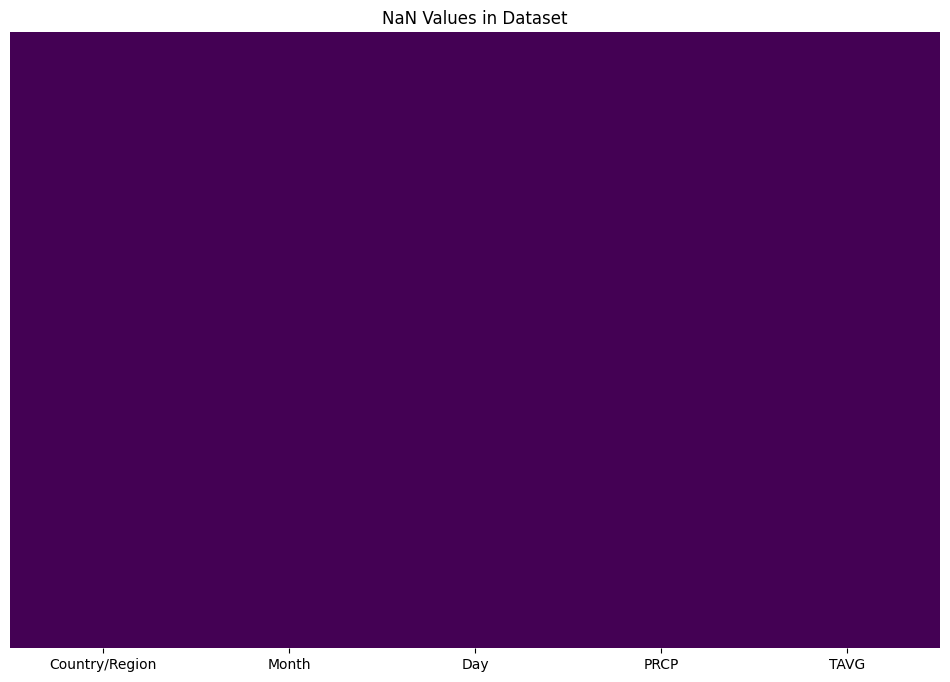

In [ ]:
nan_df = data.isnull()
plt.figure(figsize=(12, 8))
sns.heatmap(nan_df, cmap='viridis', cbar=False, yticklabels=False)
plt.title('NaN Values in Dataset')
plt.show()

In [ ]:
data.describe()

,Month,Day,PRCP,TAVG
count,589702.000000,589702.000000,589702.000000,589702.000000
mean,4.309219,15.983621,2.271451,9.991589
std,1.810580,8.783297,7.228532,11.133483
min,1.000000,1.000000,0.000000,-56.200000
25%,3.000000,8.000000,0.000000,3.400000
50%,4.000000,16.000000,0.000000,11.000000
75%,6.000000,24.000000,1.100000,17.600000
max,7.000000,31.000000,374.900000,42.700000


Converting non-numeric data into numeric data using Label Encoding

In [ ]:
country_encoder = LabelEncoder()
data['Country/Region'] = country_encoder.fit_transform(data['Country/Region'])
data.head(10)

,Country/Region,Month,Day,PRCP,TAVG
0,35,1,22,10.9,27.6
1,35,1,24,9.4,27.9
2,35,1,25,0.3,27.9
3,35,1,29,5.1,28.6
4,35,2,18,0.3,29.4
5,35,2,20,0.0,29.2
6,35,2,21,0.0,29.2
7,35,2,27,1.8,29.0
8,35,3,17,23.4,26.5
9,35,3,20,0.3,27.3


In [ ]:
tavg_data = data.copy()

Separating the features and the target variable

In [ ]:
X = tavg_data.drop(columns=['TAVG'])
y = tavg_data[['TAVG']]

In [ ]:
print('X shape:', X.shape)
print('y shape:', y.shape)

X shape: (589702, 4)
y shape: (589702, 1)


Splitting the dataset into train and test sets

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print("Train set shape:", X_train.shape, y_train.shape)
print("Test set shape:", X_test.shape, y_test.shape)

Train set shape: (471761, 4) (471761, 1)
Test set shape: (117941, 4) (117941, 1)


##Model Fitting

Simple Linear Regression

In [ ]:
model = LinearRegression()
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error:", mse)
print("Root Mean Squared Error:", rmse)
print("R-squared:", r2)

Mean Squared Error: 73.2863092310357
Root Mean Squared Error: 8.560742329438241
R-squared: 0.4078575315653865


Ridge Regression

In [ ]:
ridge_model = Ridge(alpha=0.001)
ridge_model.fit(X_train, y_train)
y_pred_ridge = ridge_model.predict(X_test)

mse_ridge = mean_squared_error(y_test, y_pred_ridge)
rmse_ridge = np.sqrt(mse_ridge)
r2_ridge = r2_score(y_test, y_pred_ridge)

print("Ridge Regression:")
print("Mean Squared Error:", mse_ridge)
print("Root Mean Squared Error:", rmse_ridge)
print("R-squared:", r2_ridge)

Ridge Regression:
Mean Squared Error: 73.28630923105965
Root Mean Squared Error: 8.560742329439641
R-squared: 0.4078575315651931


Polynomial Regression

In [ ]:
poly_features = PolynomialFeatures(degree=5)
X_train_poly = poly_features.fit_transform(X_train)
X_test_poly = poly_features.transform(X_test)
poly_model = LinearRegression()
poly_model.fit(X_train_poly, y_train)
y_pred_poly = poly_model.predict(X_test_poly)

mse_poly = mean_squared_error(y_test, y_pred_poly)
rmse_poly = np.sqrt(mse_poly)
r2_poly = r2_score(y_test, y_pred_poly)

print("Polynomial Regression:")
print("Mean Squared Error:", mse_poly)
print("Root Mean Squared Error:", rmse_poly)
print("R-squared:", r2_poly)

Polynomial Regression:
Mean Squared Error: 62.39350801267025
Root Mean Squared Error: 7.898956134368025
R-squared: 0.49586974379559345


Polynomial Regression with degree 5 gives the best result amongst all